# <center>***Credit Risk Prediction***</center>

![Alt text](Credit%20Risk.jpg)

****

## **Table of contents**

1. [Problem Statement](#Section1)<br>
<br> 
2. [Importing Pakages](#Section2)<br>
<br>
3. [Loading and cleaning Dataset](#Section3)<br>
    - 3.1 [Loading and Understanding Dataset](#Section3.1)<br>
    - 3.2 [Treating Duplicate Values](#Section3.2)<br>
    - 3.3 [Treating Missing Values](#Section3.3)<br>
<br>
4. [Exploratory Data Analysis(EDA)](#Section4)<br>
<br>
5. [Prepare data for Machine Learning Modeling](#Section5)<br>
    - 5.1 [Treating Outliers](#Section5.1)<br>
    - 5.2 [Encoding of Categorical Variables](#Section5.2)<br>
    - 5.3 [Scaling Numerical Variables](#Section5.3)<br>
    - 5.4 [Prepare Features and Target Variables (x, y)](#Section5.4)<br>
<br>
6. [Machine Learning Algorithms](#Section6)<br>
    - 6.1 [Logistic Regression](#Section6.1)<br>
        - 6.1.1 [Logistic Regression Without Tuning](#Section6.1.1)<br>
        - 6.1.2 [Logistic Regression With Tuning](#Section6.1.2)<br>
        <br>
    - 6.2 [Decision Tree](#Section6.2)<br>
        - 6.2.1 [Decision Tree Without Tuning](#Section6.2.1)<br>
        - 6.2.2 [Decision Tree With Tuning](#Section6.2.2)<br>
        <br>
    - 6.3 [Random Forest](#Section6.3)<br>
        - 6.3.1 [Random Forest Without Tuning](#Section6.3.1)<br>
        - 6.3.2 [Random Forest With Tuning](#Section6.3.2)<br>
<br>
7. [Comparing all the results](#Section7)<br>
<br>
8. [Conclusion](#Section8)



****

<a id=Section1></a>

## **1. Problem Statment**


* In the financial world, credit risks are a frequently seen phenomenon in relation to mortgages, credit cards, and other types of loans. There is always a chance that the **borrower won"t repay the loan** in full. It typically refers to the possibility that a **lender may not receive principal and interest** that is owed, which would disrupt cash flows and raise costs for collection.<br>
<br>
* Therefore, the severity of a loss can be minimized by appropriately measuring and managing credit risk.<br>
<br>
* Therefore, it's **crucial** that the lender or issuer determine and **assess the borrower's ability to repay** the debt when the applicant asks for a loan. So in this notebook, We will be doing the following stuff:<br>
    <br>
    * Load and understand the dataset<br>
    <br>
    * Clean the dataset<br>
        * Remove unwanted columns from the dataset<br>
        * Remove the duplicate values present in the dataset<br>
        * Fill the missing values accordingly<br>
    <br>
    * Exploring the Dataset(EDA)<br>
    <br>
    * Prepare the data for Machine Learning Models<br>
        * Remove Outliers<br>
        * Scaling dataset<br>
        * Encoding<br>
    <br>
    * We are going to use the three ML algorithms:<br>
        * Logistic Regression (with and without tuning)<br>
        * Decision Tree (with and without tuning)<br>
        * Random Forest (with and without tuning)<br>
        <br>
    * Finally we are going to select the best model accordingly.<br>

****

<a id=Section2></a>
## **2. Importing Pakages**

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import plotly.express as px
import warnings
warnings.filterwarnings("ignore")

****

<a id=Section3></a>
<a id=Section3.1></a>
## **3. Loading and Cleaning Dataset**
### **3.1 Loading and Understanding Dataset**

**credit_risk_dataset**

* The file credit_risk_dataset.csv contains **32581 rows** and **12 columns**.

* Detailed data description of Credit Risk dataset:

|Sr. No.|Column Name|Description|
|----|------|------|
|1|person_age|Age|
|2|person_income|Annual Income|
|3|person_home_ownership|Home ownership|
|4|person_emp_length|Employment length (in years)|
|5|loan_intent|Loan intent|
|6|loan_grade|Loan grade|
|7|loan_amnt|Loan amount|
|8|loan_int_rate|Interest rate|
|9|loan_status|Loan status (0 is non default 1 is default)|
|10|loan_percent_income|Percent income|
|11|cb_person_default_on_file|Historical default|
|12|cb_person_cred_hist_length|Credit history length|


In [4]:
data = pd.read_csv(r"credit_risk_dataset.csv")

* Let's examine the first five rows of the data using the __*head()*__ function to check for any unnecessary columns.

In [5]:
data.head()

,person_age,person_income,person_home_ownership,person_emp_length,loan_intent,loan_grade,loan_amnt,loan_int_rate,loan_status,loan_percent_income,cb_person_default_on_file,cb_person_cred_hist_length
0,22,59000,RENT,123.0,PERSONAL,D,35000,16.02,1,0.59,Y,3
1,21,9600,OWN,5.0,EDUCATION,B,1000,11.14,0,0.10,N,2
2,25,9600,MORTGAGE,1.0,MEDICAL,C,5500,12.87,1,0.57,N,3
3,23,65500,RENT,4.0,MEDICAL,C,35000,15.23,1,0.53,N,2
4,24,54400,RENT,8.0,MEDICAL,C,35000,14.27,1,0.55,Y,4


* We use the __*info()*__ function to list the datatypes of all the 12 columns in our dataset.

In [6]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32581 entries, 0 to 32580
Data columns (total 12 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   person_age                  32581 non-null  int64  
 1   person_income               32581 non-null  int64  
 2   person_home_ownership       32581 non-null  object 
 3   person_emp_length           31686 non-null  float64
 4   loan_intent                 32581 non-null  object 
 5   loan_grade                  32581 non-null  object 
 6   loan_amnt                   32581 non-null  int64  
 7   loan_int_rate               29465 non-null  float64
 8   loan_status                 32581 non-null  int64  
 9   loan_percent_income         32581 non-null  float64
 10  cb_person_default_on_file   32581 non-null  object 
 11  cb_person_cred_hist_length  32581 non-null  int64  
dtypes: float64(3), int64(5), object(4)
memory usage: 3.0+ MB


- There are 3 datatypes in our dataset:
    - __*int64*__ (Integer Numbers) **(5 Columns)**
    - __*Object*__ (This is basically a Strings, but there might be numerical data also) **(4 Columns)**
    - __*float64*__ (Decimal Numbers) **(3 Columns)**

* We will now compute some of the Dataset's fundamental statistical variables, such as the minimum, maximum, mean, and standard deviation etc. by using __*describe()*__ function.

In [7]:
data.describe()

,person_age,person_income,person_emp_length,loan_amnt,loan_int_rate,loan_status,loan_percent_income,cb_person_cred_hist_length
count,32581.000000,3.258100e+04,31686.000000,32581.000000,29465.000000,32581.000000,32581.000000,32581.000000
mean,27.734600,6.607485e+04,4.789686,9589.371106,11.011695,0.218164,0.170203,5.804211
std,6.348078,6.198312e+04,4.142630,6322.086646,3.240459,0.413006,0.106782,4.055001
min,20.000000,4.000000e+03,0.000000,500.000000,5.420000,0.000000,0.000000,2.000000
25%,23.000000,3.850000e+04,2.000000,5000.000000,7.900000,0.000000,0.090000,3.000000
50%,26.000000,5.500000e+04,4.000000,8000.000000,10.990000,0.000000,0.150000,4.000000
75%,30.000000,7.920000e+04,7.000000,12200.000000,13.470000,0.000000,0.230000,8.000000
max,144.000000,6.000000e+06,123.000000,35000.000000,23.220000,1.000000,0.830000,30.000000


* We can clearly observe that in our dataset there are several columns which contains outliers.
*  The youngest borrower is 20 years old, which is acceptable, but the oldest borrower is 144 years old, so we need to look into that.
* The minimal value for a person's employment is 0 years, which is fine, but 123 years is not!

* Since **loan_percent_income** represents the ratio of **loan_amt** to **person_income**, let's eliminate it. 

In [8]:
data.drop(columns="loan_percent_income", inplace=True)

<a id=Section3.2></a>
### **3.2 Treating Duplicate Values**

* lets drop the duplicate rows from dataset by using __*drop_duplicates*__ function.

In [9]:
data.duplicated().sum()

165

In [10]:
data.drop_duplicates(inplace=True)

In [11]:
data.duplicated().sum()

0

<a id=Section3.3></a>
### **3.3 Treating Missing Values**

In [12]:
(data.isnull().sum()/data.shape[0])*100

person_age                    0.000000
person_income                 0.000000
person_home_ownership         0.000000
person_emp_length             2.736303
loan_intent                   0.000000
loan_grade                    0.000000
loan_amnt                     0.000000
loan_int_rate                 9.547754
loan_status                   0.000000
cb_person_default_on_file     0.000000
cb_person_cred_hist_length    0.000000
dtype: float64

* There are some null values in two columns.
    1. __*person_emp_length*__ = 2.73%
    2. __*loan_int_rate*__ = 9.54%

In [13]:
print(f"person_emp_length Mode = {data.person_emp_length.mode()[0]}")
print(f"person_emp_length Median = {data.person_emp_length.median()}")
print(f"person_emp_length Mean = {round(data.person_emp_length.mean(), ndigits=2)}\n")

print(f"loan_int_rate Mode = {data.loan_int_rate.mode()[0]}")
print(f"loan_int_rate Median = {data.loan_int_rate.median()}")
print(f"loan_int_rate Mean = {round(data.loan_int_rate.mean(), ndigits=2)}")

person_emp_length Mode = 0.0
person_emp_length Median = 4.0
person_emp_length Mean = 4.79

loan_int_rate Mode = 7.51
loan_int_rate Median = 10.99
loan_int_rate Mean = 11.02


* A more cautious replacement for the null values in **"person_emp_length"** is the **mode**, which is **0 year**.
* The Interest Rate that Banks or other Financial Institutions offer on Loans is referred to as **"loan_int_rate"**. Since it differs from bank to bank, there is no set amount. Therefore I am substituting the null values with **mean**, which is **11.2**.

In [14]:
data.person_emp_length.fillna(data.person_emp_length.mode()[0], inplace=True)

In [15]:
data.loan_int_rate.fillna(data.loan_int_rate.mean(), inplace=True)

In [16]:
data.isnull().sum()

person_age                    0
person_income                 0
person_home_ownership         0
person_emp_length             0
loan_intent                   0
loan_grade                    0
loan_amnt                     0
loan_int_rate                 0
loan_status                   0
cb_person_default_on_file     0
cb_person_cred_hist_length    0
dtype: int64

* Now, we are good to go with the data for EDA.

<a id=Section4></a>
## **4. Exploratory Data Analysis(EDA)**

### 1. Let's use the borrower's age to determine the loan's status.

In [17]:
fig = px.histogram(data, x="person_age", color="loan_status", template="plotly_dark",
                   color_discrete_sequence=["white", "grey"])

fig.update_layout(title=("<b>Age Distribution with the Loan Status</b>"), title_x=0.5,
                  xaxis_title="Age", yaxis_title="Number of Borrower's",
                  width=1150, height=550, margin=dict(t=50, l=25, r=25, b=25))
fig.show()

* We can see that younger persons are more likely to default on a debt (0 is non-default, 1 is default).
* The obvious reason is also that the majority of the borowars are between the same age bracket.

### 2. Relationship between the reson for loan and Loan status.

In [18]:
fig = px.histogram(data,x="loan_intent",color="loan_status",template="plotly_dark",
                   color_discrete_sequence=["#FFAB61","#9DFF61"])

fig.update_layout(title="<b>Loan Intent with the Loan Status</b>", title_x=0.5,
                  xaxis_title="Loan Intent", yaxis_title="Number of Borrower's",
                  width=1150, height=550, margin=dict(t=50, l=25, r=25, b=25))
fig.show()

* A fascinating truth is that, medical expenses are the highest expense on loans, at least according to what they report to the lender and that the youngest borrowers are the ones most likely to fail.
* One of the reasons may be that many do not have health insurance and end up borrowing money in times of need.

### 3. Lests check the Home Ownership of the person who took the loan.

In [19]:
fig = px.histogram(data,x="person_home_ownership",color="loan_status",template="plotly_dark")

fig.update_layout(title="<b>Home Ownership with the Loan Status</b>", title_x=0.5,
                  xaxis_title="Home Ownership", yaxis_title="Number of Borrower's",
                  width=1150, height=550, margin=dict(t=50, l=25, r=25, b=25))
fig.show()

* When it comes to mortgage and rent, the percentage of people who take the loan is substantially greater.

### 4. Lets check the variation in Age, Income, Loan Amount, working years and the reson to take loan with loan status.

In [20]:
fig = px.scatter_matrix(data, dimensions=["person_age", "person_income", "loan_amnt","person_emp_length","loan_intent"],
                        color="loan_status", template="plotly_dark", color_continuous_scale="plotly3_r")

fig.update_layout(title="<b>Home Ownership with the Loan Status</b>", title_x=0.5,
                  xaxis_title="Home Ownership", yaxis_title="Number of Borrower's",
                  width=1150, height=1000)
fig.show()

### 5. relationships between the loan grade and loan status and the reason to take the loan.

In [21]:
fig = px.parallel_categories(data, dimensions=["loan_intent", "loan_grade", "loan_status"],
                             template="plotly_dark", color="loan_status", color_continuous_scale="Earth")

fig.update_layout(title="<b>Relation between Loan Intent, Grade and Status</b>", title_x=0.5,
                  width=1150, height=550)
fig.show()

* Most of the defaulters are from grade E, F, G.
* There are less defaulters from grade B, C, A.

### 6. Let's check correlation between all the columns.

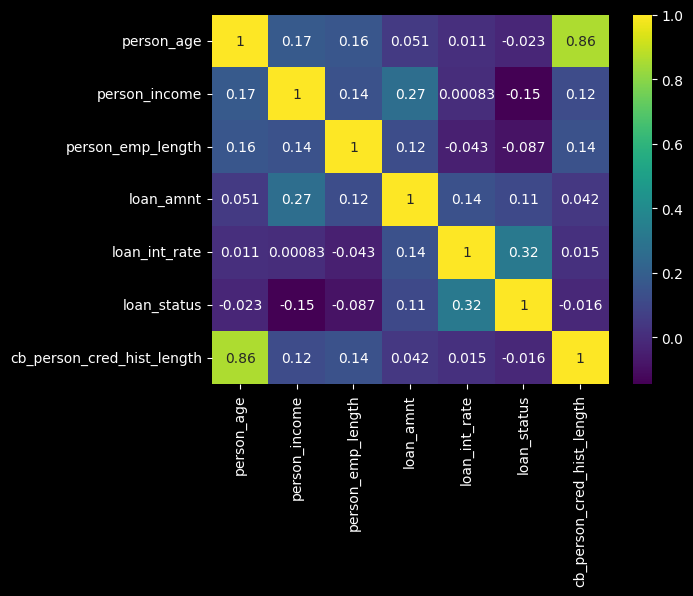

In [22]:
correlations = data.corr()
plt.style.use("dark_background")
sns.heatmap(correlations, annot=True, cmap="viridis")
plt.show()

* There is positive correlation between persons age and persons credit history. However, they are two different entities so we are not going to remove them.


<a id=Section5></a>
## **5. Prepare data for Machine Learning Modeling**

<a id=Section5.1></a>
### **5.1 Treating Outliers**

In [23]:
data_no = data.select_dtypes(exclude=["object"])
data_no.head()

,person_age,person_income,person_emp_length,loan_amnt,loan_int_rate,loan_status,cb_person_cred_hist_length
0,22,59000,123.0,35000,16.02,1,3
1,21,9600,5.0,1000,11.14,0,2
2,25,9600,1.0,5500,12.87,1,3
3,23,65500,4.0,35000,15.23,1,2
4,24,54400,8.0,35000,14.27,1,4


In [24]:
for i in data_no.columns:
    fig = px.box(data[i], template="plotly_dark")
    fig.update_layout(title=f"<b>{i}</b>", title_x=0.5)
    fig.show()

* We must remove the outliers from **"person_age"**, **"person_income"**, **"person_emp_length"** and **"loan_amnt"** to acchive the optimum results while training the model.

In [25]:
outlier_veriables = ["person_age", "person_income", "person_emp_length", "loan_amnt"]

In [26]:
data.shape

(32416, 11)

* We have total **32416 rows** before removeing outliers.

In [27]:
def outlier_remove(data,outlier_veriables):
    """
    This function removes outliers from the dataset and returns new DataFrame.

    Args:
        data (DataFrame): Takes the DataFrame from which you want to remove outliers.
        outlier_veriables (list): Takes the list of variables from which you want to remove outliers.

    Returns:
        DataFrame: Returns the new DataFrame without outliers.
    """
    
    import pandas as pd

    df = pd.DataFrame()
    
    for i in outlier_veriables:
        Q1 = data[i].quantile(0.25)
        Q3 = data[i].quantile(0.75)

        IQR = Q3 - Q1

        lower_limit = Q1 - 2*IQR
        upper_limit = Q3 + 2*IQR

        df_ouliers = data[(data[i]<=lower_limit) | (data[i]>=upper_limit)]
        df = df.append(df_ouliers)
        
    df.drop_duplicates(inplace=True)

    df_with_outliers = data.append(df)
    df_without_outliers = df_with_outliers.drop_duplicates(keep=False)
    
    return df_without_outliers

In [28]:
data = outlier_remove(data,outlier_veriables)
data.shape

(29976, 11)

* After removing the outliers we got **29976 rows**.

<a id=Section5.2></a>
### **5.2 Encoding of Categorical Variables**

Label encoding is used to transform the categorical data into numerical data.

In [29]:
encoding_veriables = ["person_home_ownership", "loan_intent", "loan_grade", "cb_person_default_on_file"]

In [30]:
def encoding(data,encoding_veriables):
    """
    This function is used for encoding categorical variables and returns new DataFrame.

    Args:
        data (DataFrame): Takes the DataFrame from which you want to transform categorical variables.
        encoding_veriables (list): Takes the list of variables from which you want to transform categorical variables.

    Returns:
        DataFrame: Returns the new DataFrame with Encoding variables.
    """

    from sklearn import preprocessing
    label_encoder = preprocessing.LabelEncoder()

    for i in encoding_veriables:
        data[i] = label_encoder.fit_transform(data[i])

    return data

In [31]:
data = encoding(data,encoding_veriables)
data.head()

,person_age,person_income,person_home_ownership,person_emp_length,loan_intent,loan_grade,loan_amnt,loan_int_rate,loan_status,cb_person_default_on_file,cb_person_cred_hist_length
1,21,9600,2,5.0,1,1,1000,11.14,0,0,2
2,25,9600,0,1.0,3,2,5500,12.87,1,0,3
5,21,9900,2,2.0,5,0,2500,7.14,1,0,2
9,21,10000,2,6.0,5,3,1600,14.74,1,0,3
11,21,10000,2,2.0,2,0,4500,8.63,1,0,2


<a id=Section5.3></a>
### **5.3 Scaling Numerical Variables**

StandardScaler is used to transform the data into one scale.

In [32]:
from sklearn.preprocessing import StandardScaler

features = data[data.columns.difference(["loan_status"])]
target = data[["loan_status"]]

scaler = StandardScaler()
model = scaler.fit(features)
data_norm = model.transform(features)

In [33]:
features = pd.DataFrame(data_norm, columns=features.columns)
features.head()

,cb_person_cred_hist_length,cb_person_default_on_file,loan_amnt,loan_grade,loan_int_rate,loan_intent,person_age,person_emp_length,person_home_ownership,person_income
0,-0.978465,-0.4618,-1.430376,-0.182024,0.048751,-0.880279,-1.228179,0.168609,0.199016,-1.700209
1,-0.688595,-0.4618,-0.639695,0.680232,0.612779,0.274347,-0.397088,-0.936499,-1.201551,-1.700209
2,-0.978465,-0.4618,-1.166816,-1.044281,-1.255359,1.428973,-1.228179,-0.660222,0.199016,-1.690015
3,-0.688595,-0.4618,-1.324952,1.542489,1.222450,1.428973,-1.228179,0.444885,0.199016,-1.686617
4,-0.978465,-0.4618,-0.815402,-1.044281,-0.769578,-0.302966,-1.228179,-0.660222,0.199016,-1.686617


<a id=Section5.4></a>
### **5.4 Prepare Features and Target Variables (x, y)**

In [34]:
x = features
y = target

In [35]:
(y.value_counts()/data.shape[0])*100

loan_status
0              77.908994
1              22.091006
dtype: float64

In [36]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.30, random_state=100)

In [37]:
print(f"x_train = {x_train.shape}")
print(f"x_test = {x_test.shape}\n")

print(f"y_train = {y_train.shape}")
print(f"y_test = {y_test.shape}")

x_train = (20983, 10)
x_test = (8993, 10)

y_train = (20983, 1)
y_test = (8993, 1)


<a id=Section6></a>
## **6. Machine Learning Algorithms**

<a id=Section6.1></a>
<a id=Section6.1.1></a>
### **6.1 Logistic Regression**
#### **6.1.1 Logistic Regression Without Tuning**
To apply any machine learning algorithm on your dataset, basically there are 4 steps:
1. Load the algorithm
2. Instantiate and Fit the model to the training dataset
3. Prediction on the test set
4. Evaluate the model.

In [38]:
from sklearn.linear_model import LogisticRegression

lr = LogisticRegression()
lr.fit(x_train, y_train)

LogisticRegression()

In [39]:
y_pred_test_lr = lr.predict(x_test)
y_pred_train_lr = lr.predict(x_train)

##### **Model Evaluation**

* **By Accuracy , Precision and Recall**

In [40]:
def APR(y_train, y_test, y_pred_train_model, y_pred_test_model):
    """
        This fuction is used to get the accuracy, precision and recall of the given model.

        Args:
        y_train (Series, DataFrame): It takes the train data of target variable.
        y_test (Series, DataFrame): It takes the test data of target variable.
        y_pred_train_model (Series, DataFrame): It takes the train data of target variable after fitting to the model.
        y_pred_test_model (Series, DataFrame): It takes the test data of target variable after fitting to the model.
    """

    from sklearn.metrics import accuracy_score
    from sklearn.metrics import precision_score
    from sklearn.metrics import recall_score

    model_evaluation_APR = {"Train":[round(accuracy_score(y_train, y_pred_train_model)*100,ndigits=2),
                                    round(precision_score(y_train, y_pred_train_model)*100,ndigits=2),
                                    round(recall_score(y_train, y_pred_train_model)*100,ndigits=2)],

                            "Test":[round(accuracy_score(y_test, y_pred_test_model)*100,ndigits=2),
                                    round(precision_score(y_test, y_pred_test_model)*100,ndigits=2),
                                    round(recall_score(y_test, y_pred_test_model)*100,ndigits=2)]}

    model_evaluation_APR = pd.DataFrame(model_evaluation_APR, index=["Accuracy","Precision", "Recall"])
    display(model_evaluation_APR.style.background_gradient(cmap="OrRd_r"))

In [41]:
APR(y_train, y_test, y_pred_train_lr, y_pred_test_lr)

,Train,Test
Accuracy,83.760000,83.800000
Precision,71.610000,74.710000
Recall,42.320000,43.470000


* **By Confusion Matrix**

In [42]:
def confusion_matrix(y_train, y_test, y_pred_train_model, y_pred_test_model):
    """
        This fuction is used to get the accuracy, precision and recall of the given model.

        Args:
        y_train (Series, DataFrame): It takes the train data of target variable.
        y_test (Series, DataFrame): It takes the test data of target variable.
        y_pred_train_model (Series, DataFrame): It takes the train data of target variable after fitting to the model.
        y_pred_test_model (Series, DataFrame): It takes the test data of target variable after fitting to the model.
    """
    
    from sklearn.metrics import confusion_matrix
    import pandas as pd

    conf_mtx_train_model = pd.DataFrame(confusion_matrix(y_train,y_pred_train_model),
                                    index=["Actual No Default","Actual Default"],
                                    columns = ["Predicted No Default","Predicted Default"])

    print("Confusion Matrix for Train :")
    display(conf_mtx_train_model.style.background_gradient(cmap="bwr_r"))

    conf_mtx_test_model = pd.DataFrame(confusion_matrix(y_test,y_pred_test_model),
                                index=["Actual No Default","Actual Default"],
                                columns = ["Predicted No Default","Predicted Default"])

    print("Confusion Matrix for Test :")
    display(conf_mtx_test_model.style.background_gradient(cmap="bwr_r"))

In [43]:
confusion_matrix(y_train, y_test, y_pred_train_lr, y_pred_test_lr)

Confusion Matrix for Train :


,Predicted No Default,Predicted Default
Actual No Default,15638,768
Actual Default,2640,1937


Confusion Matrix for Test :


,Predicted No Default,Predicted Default
Actual No Default,6647,301
Actual Default,1156,889


<a id=Section6.1.2></a>
#### **6.1.2 Logistic Regression With Tuning**

To apply any machine learning algorithm on your dataset, basically there are 4 steps:
1. Load the algorithm
2. Instantiate and Fit the model to the training dataset
3. Prediction on the test set
4. Evaluate the model.

* here we can skip the first 2 steps which we have already executed.
* here we can take the probabilities into consideration for fine tuning.
* By default the probabilities set for binary classification are 50-50% 

In [44]:
y_pred_train_lr_tune = np.where(lr.predict_proba(x_train)[:,1]> 0.2,1,0)
y_pred_test_lr_tune = np.where(lr.predict_proba(x_test)[:,1]> 0.2,1,0)

##### **Model Evaluation**

* **By Accuracy, Precision and Recall**

In [45]:
APR(y_train, y_test, y_pred_train_lr_tune, y_pred_test_lr_tune)

,Train,Test
Accuracy,73.550000,74.150000
Precision,44.150000,46.090000
Recall,80.290000,80.780000


* **By Confusion Matrix**

In [46]:
confusion_matrix(y_train, y_test, y_pred_train_lr_tune, y_pred_test_lr_tune)

Confusion Matrix for Train :


,Predicted No Default,Predicted Default
Actual No Default,11758,4648
Actual Default,902,3675


Confusion Matrix for Test :


,Predicted No Default,Predicted Default
Actual No Default,5016,1932
Actual Default,393,1652


* **By Roc_AUC Curve**

In [47]:
def roc_auc_curve(model, x_train, x_test, y_train, y_test):
    """
    This funtion is used to plot ROC_AUC curve.

    Args:
        model : Machine Learning Model
        x_train (Series, DataFrame): Features of training data
        x_test (Series, DataFrame): Features of test data
        y_train (Series, DataFrame): Target of training data
        y_test (Series, DataFrame): Target of test data
    """

    from sklearn.metrics import roc_curve, auc

    train_proba = model.predict_proba(x_train)[:,1]
    test_proba = model.predict_proba(x_test)[:,1]
    
    y_data=[y_train,y_test]
    proba_data=[train_proba, test_proba]
    train_test=["Train", "Test"]
    num = [1,2]
    color = ["red", "Blue"]
    for i in range(2):

        fpr, tpr, threshold = roc_curve(y_data[i], proba_data[i])
        roc_auc_dt = auc(fpr, tpr)

        plt.figure(figsize=(10,5))
        plt.subplot(1,2,num[i])
        plt.plot(fpr, tpr, label="AUC=%0.3f"%roc_auc_dt, color=color[i])
        plt.plot([0, 1], [0, 1], color='yellow', linestyle='--')
        plt.xlim([-0.05, 1.05])
        plt.ylim([-0.05, 1.05])
        plt.title(f"ROC_AUC Curve for {train_test[i]}")
        plt.legend(loc="lower right")
        plt.xlabel("False Positive Rate")
        plt.ylabel("True Positive Rate")
        plt.fill_between(fpr, tpr, color='green', alpha=0.4)
        plt.show()
        

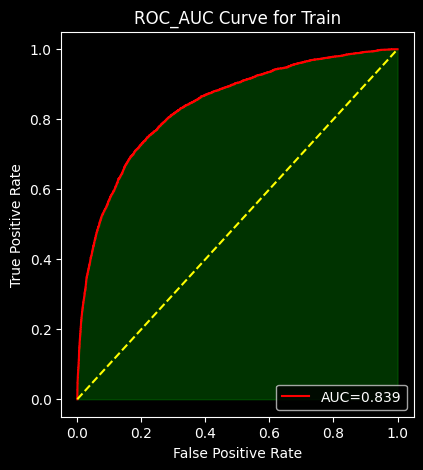

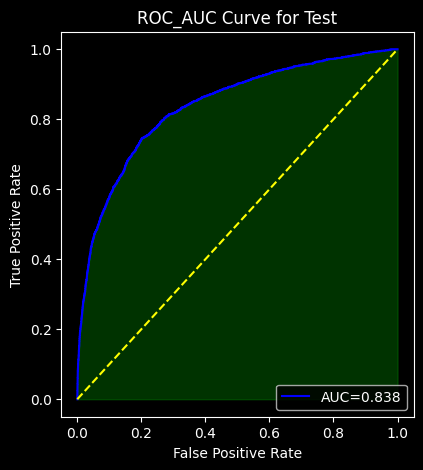

In [48]:
roc_auc_curve(lr, x_train, x_test, y_train, y_test)

<a id=Section6.2></a>
<a id=Section6.2.1></a>
### **6.2 Decision Tree**
#### **6.2.1 Decision Tree Without Tuning**

To apply any machine learning algorithm on your dataset, basically there are 4 steps:
1. Load the algorithm
2. Instantiate and Fit the model to the training dataset
3. Prediction on the test set
4. Evaluate the model.


In [49]:
from sklearn.tree import DecisionTreeClassifier

dt = DecisionTreeClassifier(criterion="gini")
dt.fit(x_train, y_train)

DecisionTreeClassifier()

In [50]:
from sklearn import tree
plt.figure(figsize=(400,60))
fig = tree.plot_tree(dt, feature_names=x.columns, class_names=['No Default', "Default"],
                     filled=True, fontsize=10)

In [51]:
y_pred_train_dt = dt.predict(x_train)
y_pred_test_dt = dt.predict(x_test)

##### **Model Evaluation**

* **By Accuracy, Precision and Recall**

In [52]:
APR(y_train, y_test, y_pred_train_dt, y_pred_test_dt)

,Train,Test
Accuracy,100.000000,88.540000
Precision,100.000000,74.490000
Recall,100.000000,75.400000


* **By Confusion Matrix**

In [53]:
confusion_matrix(y_train, y_test, y_pred_train_dt, y_pred_test_dt)

Confusion Matrix for Train :


,Predicted No Default,Predicted Default
Actual No Default,16406,0
Actual Default,0,4577


Confusion Matrix for Test :


,Predicted No Default,Predicted Default
Actual No Default,6420,528
Actual Default,503,1542


* **By Roc_AUC Curve**

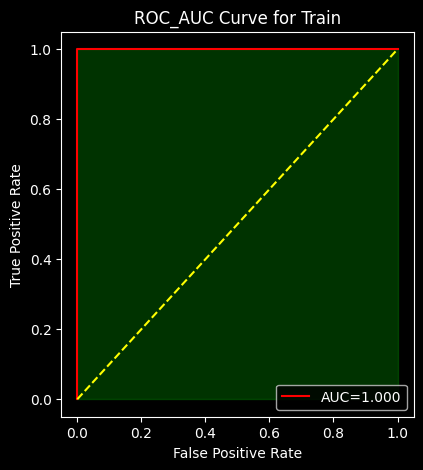

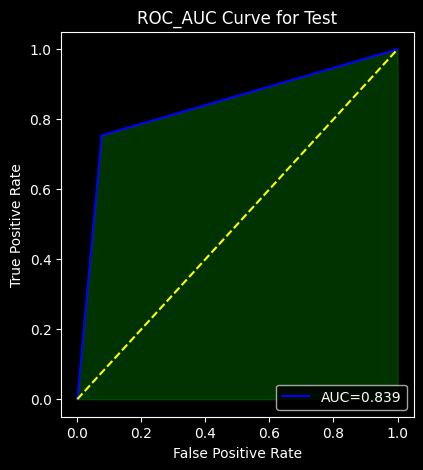

In [54]:
roc_auc_curve(dt, x_train, x_test, y_train, y_test)

<a id=Section6.2.2></a>
#### **6.2.2 Decision Tree With Tuning**

For tuning purpose we are going to apply GridSearchCV with the following parameters to get best estimator:
- criterion
- max_depth
- max_features



In [55]:
from sklearn.model_selection import GridSearchCV

dt_classifier = DecisionTreeClassifier(random_state=0)

tree_para = [{"criterion":["gini","entropy","log_loss"],
              "max_depth":range(5,11),
              "max_features":[5, "log2", None],
              "splitter":["best","random"],
              "min_samples_split":range(12,15)}]

dt_GSCV = GridSearchCV(dt_classifier, tree_para, cv=10, refit="AUC", scoring="recall", n_jobs=-1)                          

In [56]:
dt_GSCV.fit(x_train, y_train)

GridSearchCV(cv=10, estimator=DecisionTreeClassifier(random_state=0), n_jobs=-1,
             param_grid=[{'criterion': ['gini', 'entropy', 'log_loss'],
                          'max_depth': range(5, 11),
                          'max_features': [5, 'log2', None],
                          'min_samples_split': range(12, 15),
                          'splitter': ['best', 'random']}],
             refit='AUC', scoring='recall')

In [57]:
print(dt_GSCV.best_params_)
best_estimator = dt_GSCV.best_estimator_
print(best_estimator)

{'criterion': 'gini', 'max_depth': 10, 'max_features': None, 'min_samples_split': 12, 'splitter': 'best'}
DecisionTreeClassifier(max_depth=10, min_samples_split=12, random_state=0)


In [58]:
from sklearn import tree
plt.figure(figsize=(300,30))
fig = tree.plot_tree(best_estimator, feature_names=x.columns, class_names=['No Default', "Default"],
                     filled=True, fontsize=10)

In [59]:
y_pred_test_dt_GSCV = dt_GSCV.predict(x_test)
y_pred_train_dt_GSCV = dt_GSCV.predict(x_train)

##### **Model Evaluation**

* **By Accuracy, Precision and Recall**

In [60]:
APR(y_train, y_test, y_pred_train_dt_GSCV, y_pred_test_dt_GSCV)

,Train,Test
Accuracy,93.700000,92.030000
Precision,97.020000,93.120000
Recall,73.370000,70.120000


* **By Confusion Matrix**

In [61]:
confusion_matrix(y_train, y_test, y_pred_train_dt_GSCV, y_pred_test_dt_GSCV)

Confusion Matrix for Train :


,Predicted No Default,Predicted Default
Actual No Default,16303,103
Actual Default,1219,3358


Confusion Matrix for Test :


,Predicted No Default,Predicted Default
Actual No Default,6842,106
Actual Default,611,1434


* **By ROC_AUC Curve**

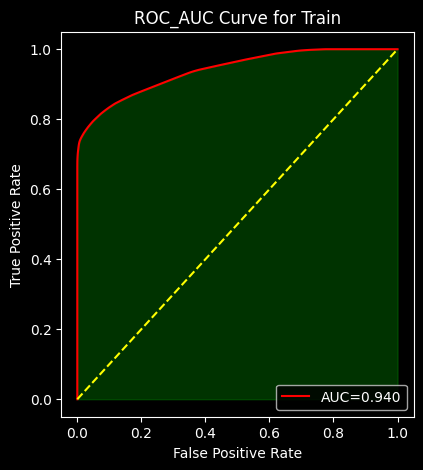

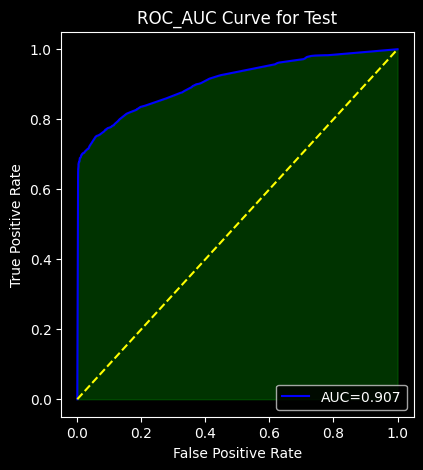

In [62]:
roc_auc_curve(dt_GSCV, x_train, x_test, y_train, y_test)

<a id=Section6.3></a>
<a id=Section6.3.1></a>
### **6.3 Random Forest**
#### **6.3.1 Random Forest Without Tuning**

To apply any machine learning algorithm on your dataset, basically there are 4 steps:
1. Load the algorithm
2. Instantiate and Fit the model to the training dataset
3. Prediction on the test set
4. Evaluate the model.


In [63]:
from sklearn.ensemble import RandomForestClassifier

rf = RandomForestClassifier(random_state=0)
rf.fit(x_train, y_train)

RandomForestClassifier(random_state=0)

In [64]:
y_pred_train_rf = rf.predict(x_train)
y_pred_test_rf = rf.predict(x_test)

##### **Model Evaluation**

* **By Accuracy, Precison and Recall**

In [65]:
APR(y_train, y_test, y_pred_train_rf, y_pred_test_rf)

,Train,Test
Accuracy,100.000000,92.310000
Precision,100.000000,94.950000
Recall,100.000000,69.880000


* **By Confusion Matrix**

In [66]:
confusion_matrix(y_train, y_test, y_pred_train_rf, y_pred_test_rf)

Confusion Matrix for Train :


,Predicted No Default,Predicted Default
Actual No Default,16406,0
Actual Default,0,4577


Confusion Matrix for Test :


,Predicted No Default,Predicted Default
Actual No Default,6872,76
Actual Default,616,1429


* **By ROC_AUC Curve**

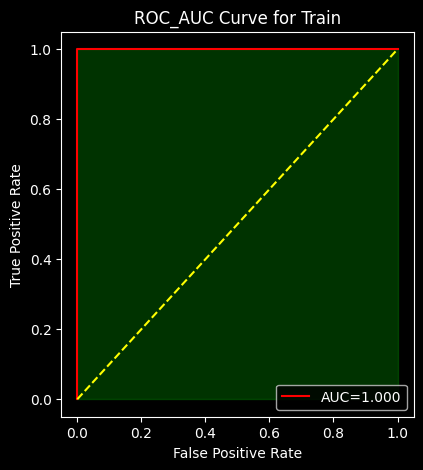

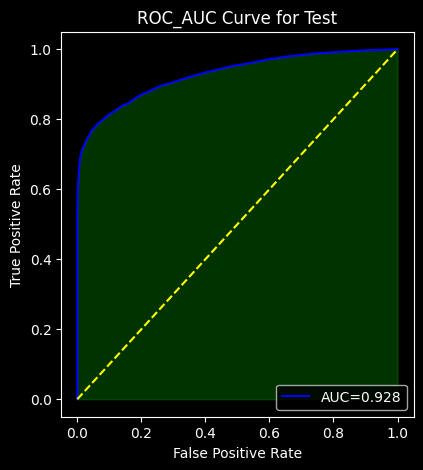

In [67]:
roc_auc_curve(rf, x_train, x_test, y_train, y_test)

<a id=Section6.3.2></a>
#### **6.3.2 Random Forest With Tuning**

For tuning purpose we are going to apply RandomizedSearchCV with the following parameters to get best estimator:
- max_depth
- min_samples_split
- min_samples_leaf
- bootstrap
- n_estimators
- criterion
- max_features



In [68]:
from sklearn.model_selection import RandomizedSearchCV

for_para = {"criterion":["gini", "entropy"],
            "max_depth":range(3,6),
            "max_features":["sqrt", "log2", 5],
            "min_samples_split":range(6,9),
            "min_samples_leaf":range(1,3),
            "bootstrap":[True,False],
            "n_estimators":[100,400]}

rf_RSCV = RandomizedSearchCV(rf, param_distributions=for_para, n_iter=100, n_jobs=-1)

In [69]:
rf_RSCV.fit(x_train, y_train)

RandomizedSearchCV(estimator=RandomForestClassifier(random_state=0), n_iter=100,
                   n_jobs=-1,
                   param_distributions={'bootstrap': [True, False],
                                        'criterion': ['gini', 'entropy'],
                                        'max_depth': range(3, 6),
                                        'max_features': ['sqrt', 'log2', 5],
                                        'min_samples_leaf': range(1, 3),
                                        'min_samples_split': range(6, 9),
                                        'n_estimators': [100, 400]})

In [70]:
print(rf_RSCV.best_params_)
best_estimator_rf_tune = rf_RSCV.best_estimator_
print(rf_RSCV.best_estimator_)

{'n_estimators': 400, 'min_samples_split': 7, 'min_samples_leaf': 1, 'max_features': 5, 'max_depth': 5, 'criterion': 'entropy', 'bootstrap': False}
RandomForestClassifier(bootstrap=False, criterion='entropy', max_depth=5,
                       max_features=5, min_samples_split=7, n_estimators=400,
                       random_state=0)


In [71]:
y_pred_train_rf_RSCV = rf_RSCV.predict(x_train)
y_pred_test_rf_RSCV = rf_RSCV.predict(x_test)

##### **Model Evaluation**

* **By Accuracy, Precison and Recall**

In [72]:
APR(y_train, y_test, y_pred_train_rf_RSCV, y_pred_test_rf_RSCV)

,Train,Test
Accuracy,89.610000,88.710000
Precision,93.820000,92.770000
Recall,56.040000,54.620000


* **By Confusion Matrix**

In [73]:
confusion_matrix(y_train, y_test, y_pred_train_rf_RSCV, y_pred_test_rf_RSCV)

Confusion Matrix for Train :


,Predicted No Default,Predicted Default
Actual No Default,16237,169
Actual Default,2012,2565


Confusion Matrix for Test :


,Predicted No Default,Predicted Default
Actual No Default,6861,87
Actual Default,928,1117


* **By ROC_AUC Curve**

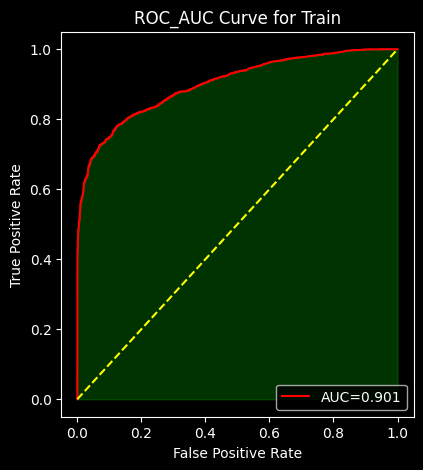

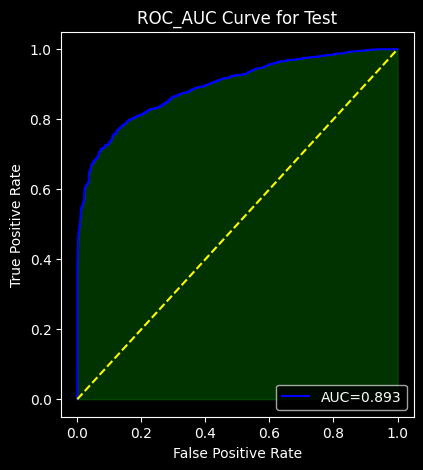

In [74]:
roc_auc_curve(rf_RSCV, x_train, x_test, y_train, y_test)

****

<a id=Section7></a>
## **7. Comparing all the results**

In [75]:
from sklearn.metrics import accuracy_score, precision_score, recall_score
model_evaluation_final = pd.DataFrame({"Model":["Logistic Regression", "Logistic Regression Tuning",
                                                "Decision Tree", "Decision Tree Tuning",
                                                "Random Forest", "Random Forest Tuning",

                                                "Logistic Regression", "Logistic Regression Tuning",
                                                "Decision Tree", "Decision Tree Tuning",
                                                "Random Forest", "Random Forest Tuning",

                                                "Logistic Regression", "Logistic Regression Tuning",
                                                "Decision Tree", "Decision Tree Tuning",
                                                "Random Forest", "Random Forest Tuning"],
                    
                                        "A/P/R":["Accuracy","Accuracy",
                                                 "Accuracy","Accuracy",
                                                 "Accuracy","Accuracy",

                                                 "Precision", "Precision",
                                                 "Precision", "Precision",
                                                 "Precision", "Precision",

                                                 "Recall", "Recall",
                                                 "Recall", "Recall",
                                                 "Recall", "Recall"],

                                        "Train":[round(accuracy_score(y_train, y_pred_train_lr)*100,ndigits=2),round(accuracy_score(y_train, y_pred_train_lr_tune)*100,ndigits=2),
                                                 round(accuracy_score(y_train, y_pred_train_dt)*100,ndigits=2),round(accuracy_score(y_train, y_pred_train_dt_GSCV)*100,ndigits=2),
                                                 round(accuracy_score(y_train, y_pred_train_rf)*100,ndigits=2),round(accuracy_score(y_train, y_pred_train_rf_RSCV)*100,ndigits=2),

                                                 round(precision_score(y_train, y_pred_train_lr)*100,ndigits=2),round(precision_score(y_train, y_pred_train_lr_tune)*100,ndigits=2),
                                                 round(precision_score(y_train, y_pred_train_dt)*100,ndigits=2),round(precision_score(y_train, y_pred_train_dt_GSCV)*100,ndigits=2),
                                                 round(precision_score(y_train, y_pred_train_rf)*100,ndigits=2),round(precision_score(y_train, y_pred_train_rf_RSCV)*100,ndigits=2),

                                                 round(recall_score(y_train, y_pred_train_lr)*100,ndigits=2),round(recall_score(y_train, y_pred_train_lr_tune)*100,ndigits=2),
                                                 round(recall_score(y_train, y_pred_train_dt)*100,ndigits=2),round(recall_score(y_train, y_pred_train_dt_GSCV)*100,ndigits=2),
                                                 round(recall_score(y_train, y_pred_train_rf)*100,ndigits=2),round(recall_score(y_train, y_pred_train_rf_RSCV)*100,ndigits=2)],

                                        "Test":[round(accuracy_score(y_test, y_pred_test_lr)*100,ndigits=2),round(accuracy_score(y_test, y_pred_test_lr_tune)*100,ndigits=2),
                                                round(accuracy_score(y_test, y_pred_test_dt)*100,ndigits=2),round(accuracy_score(y_test, y_pred_test_dt_GSCV)*100,ndigits=2),
                                                round(accuracy_score(y_test, y_pred_test_rf)*100,ndigits=2),round(accuracy_score(y_test, y_pred_test_rf_RSCV)*100,ndigits=2),


                                                round(precision_score(y_test, y_pred_test_lr)*100,ndigits=2),round(precision_score(y_test, y_pred_test_lr_tune)*100,ndigits=2),
                                                round(precision_score(y_test, y_pred_test_dt)*100,ndigits=2),round(precision_score(y_test, y_pred_test_dt_GSCV)*100,ndigits=2),
                                                round(precision_score(y_test, y_pred_test_rf)*100,ndigits=2),round(precision_score(y_test, y_pred_test_rf_RSCV)*100,ndigits=2),

                                                round(recall_score(y_test, y_pred_test_lr)*100,ndigits=2),round(recall_score(y_test, y_pred_test_lr_tune)*100,ndigits=2),
                                                round(recall_score(y_test, y_pred_test_dt)*100,ndigits=2),round(recall_score(y_test, y_pred_test_dt_GSCV)*100,ndigits=2),
                                                round(recall_score(y_test, y_pred_test_rf)*100,ndigits=2),round(recall_score(y_test, y_pred_test_rf_RSCV)*100,ndigits=2)]})

display(model_evaluation_final.style.background_gradient(cmap="binary_r"))

,Model,A/P/R,Train,Test
0,Logistic Regression,Accuracy,83.760000,83.800000
1,Logistic Regression Tuning,Accuracy,73.550000,74.150000
2,Decision Tree,Accuracy,100.000000,88.540000
3,Decision Tree Tuning,Accuracy,93.700000,92.030000
4,Random Forest,Accuracy,100.000000,92.310000
5,Random Forest Tuning,Accuracy,89.610000,88.710000
6,Logistic Regression,Precision,71.610000,74.710000
7,Logistic Regression Tuning,Precision,44.150000,46.090000
8,Decision Tree,Precision,100.000000,74.490000
9,Decision Tree Tuning,Precision,97.020000,93.120000


****

<a id=Section8></a>
## **8. Conclusion**

* While predicting the person is goging to default or not Recall is very crucial parameter to control.

* Because we must have to reduce the False Negative (Type II Error).

* We are going to select the Decision Tree model with the tuning parameters.

* The Decision Tree model was chosen because it provided the best Recall during testing and training.

|A/P/R|Train|Test|
|-----|-----|----|
|*Accuracy*|*93.70%*|*92.03%*|
|Precision|97.02%|93.12%|
|**Recall**|**73.37%**|**70.12%**|
|AUC|94%|90.07%|